# Imports 

In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn as sk

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject


# Question 1

# Question 2
For this problem you must use PyTorch. For this problem you will use a CNN that has
been trained on ImageNet-1k. You may use any pre-trained architecture developed from
2014 onwards (e.g., not AlexNet, but a VGG or ResNet model would be fine). The CNN
needs to produce d-dimensional embeddings that are fed into the 1000-way output layer,
where d is typically 512, 2048, or 4096. You will be re-using the CNN you select in the
next problem for transfer learning with embeddings.

## Part 1: Using Pre-Trained Deep CNN (5 points)
Run it on peppers.jpg. Output the top-3 predicted categories and the probabilities. State
the pre-trained CNN model that you used.
Make sure to pre-process the input image appropriately. Look at the toolbox documenta-
tion for the pre-trained model you use to determine how to do this.

## Part 2: Visualizing Feature Maps (5 points)
Write code to visualize the feature maps in the network as images. You will likely need to
normalize the values between 0 and 1 to do this.
Choose five interesting feature maps from early in the network, five from the the middle of
the network, and and five close to the end of the network. Display them to us and discuss
the structure of the feature maps. Try to find some that are interpretable, and discuss the
challenges in doing so.

/Users/wdaugherty/opt/anaconda3/lib/python3.9/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: dlopen(/Users/wdaugherty/opt/anaconda3/lib/python3.9/site-packages/torchvision/image.so, 0x0006): Symbol not found: __ZN2at4_ops19empty_memory_format4callEN3c108ArrayRefIxEENS2_8optionalINS2_10ScalarTypeEEENS5_INS2_6LayoutEEENS5_INS2_6DeviceEEENS5_IbEENS5_INS2_12MemoryFormatEEE
  Referenced from: <C47CB971-B96A-38B8-AEAA-A7DAA535BE54> /Users/wdaugherty/opt/anaconda3/lib/python3.9/site-packages/torchvision/image.so
  Expected in:     <18497461-1393-3DF8-BED0-DC986FDB1051> /Users/wdaugherty/opt/anaconda3/lib/python3.9/site-packages/torch/lib/libtorch_cpu.dylib
  warn(f"Failed to load image Python extension: {e}")
/Users/wdaugherty/opt/anaconda3/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/Users

Total convolutional layers: 17


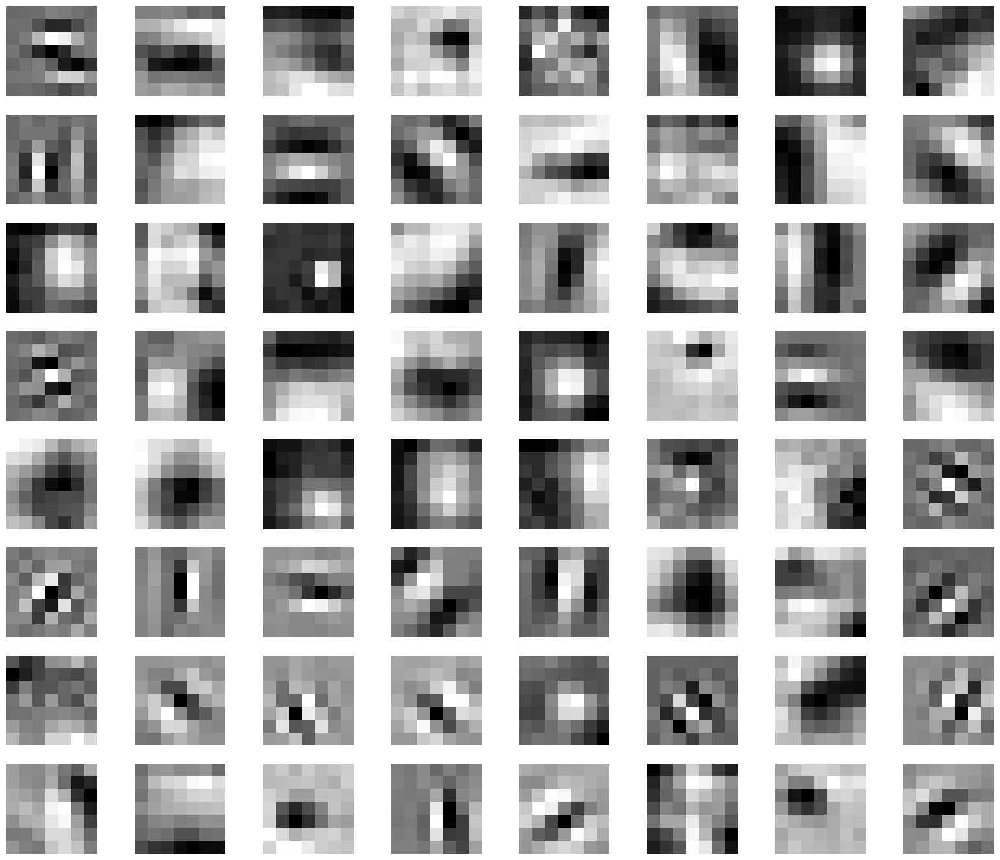

torch.Size([64, 112, 112])
Saving layer 0 feature maps...


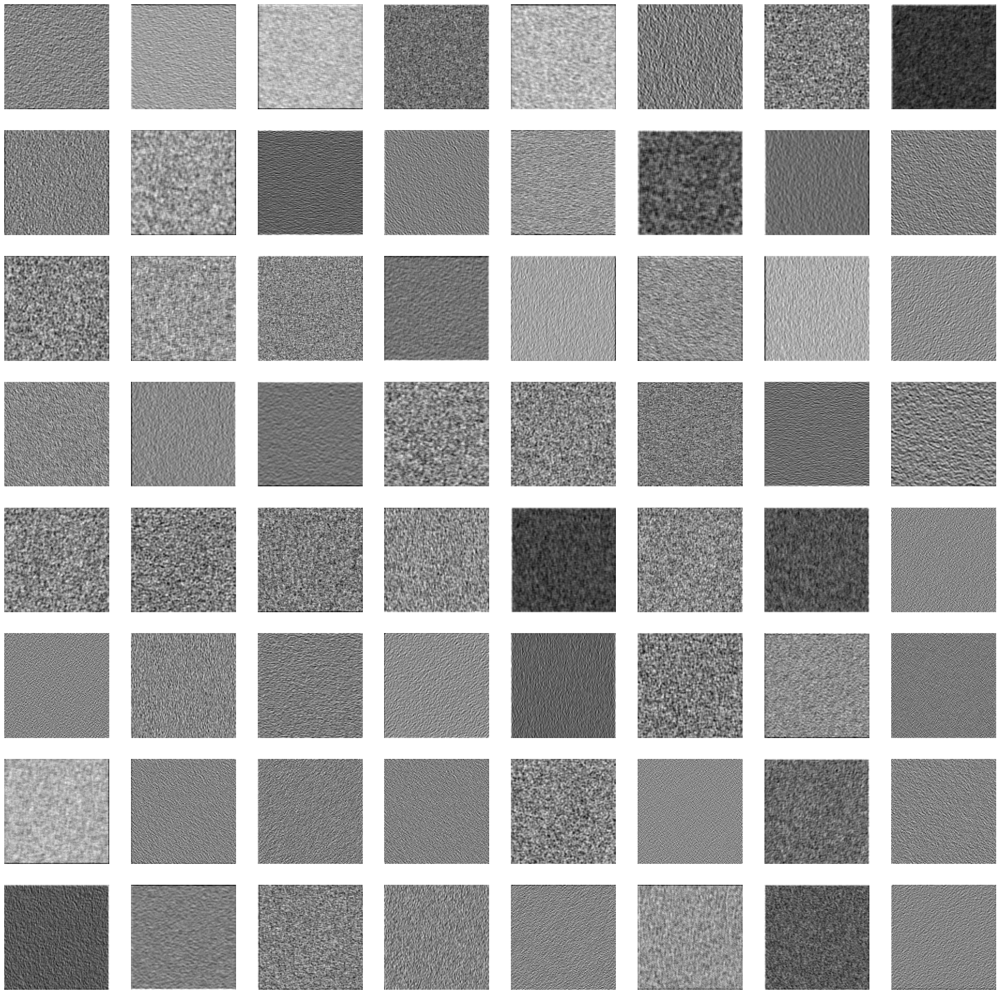

torch.Size([64, 112, 112])
Saving layer 1 feature maps...


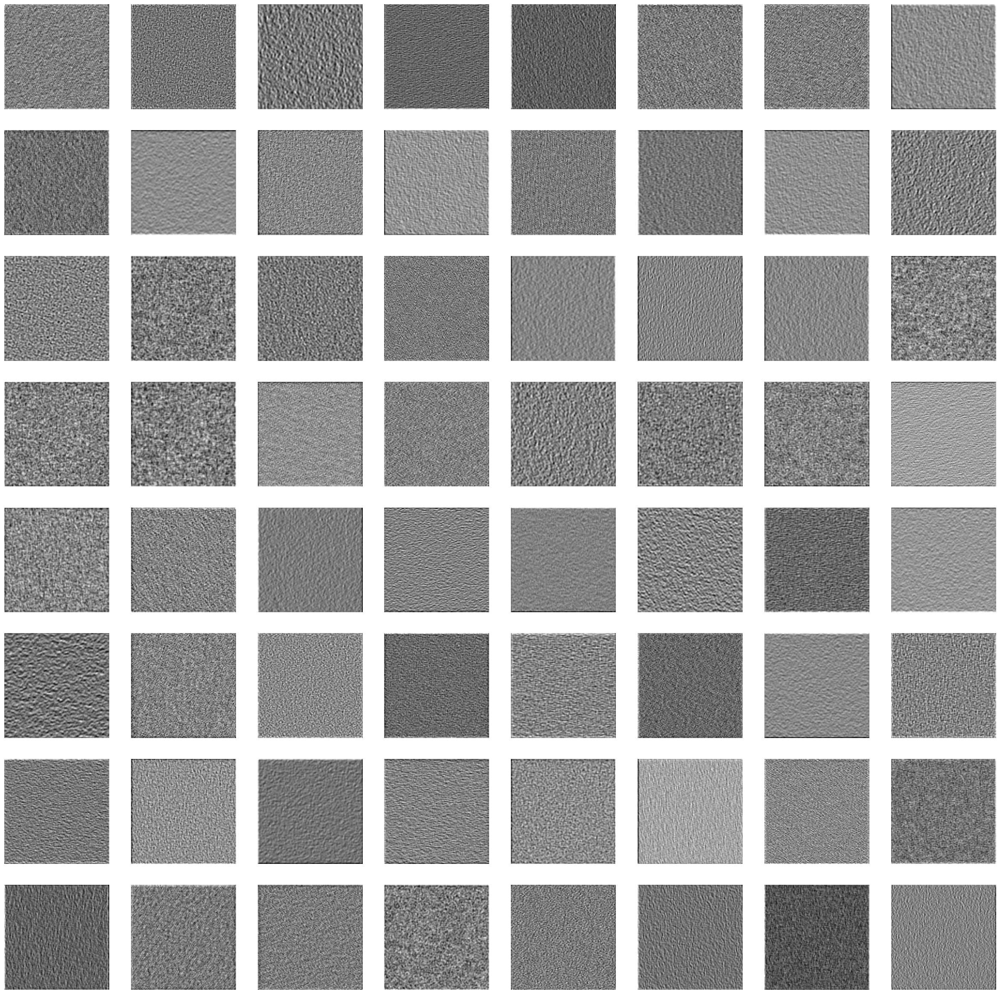

torch.Size([64, 112, 112])
Saving layer 2 feature maps...


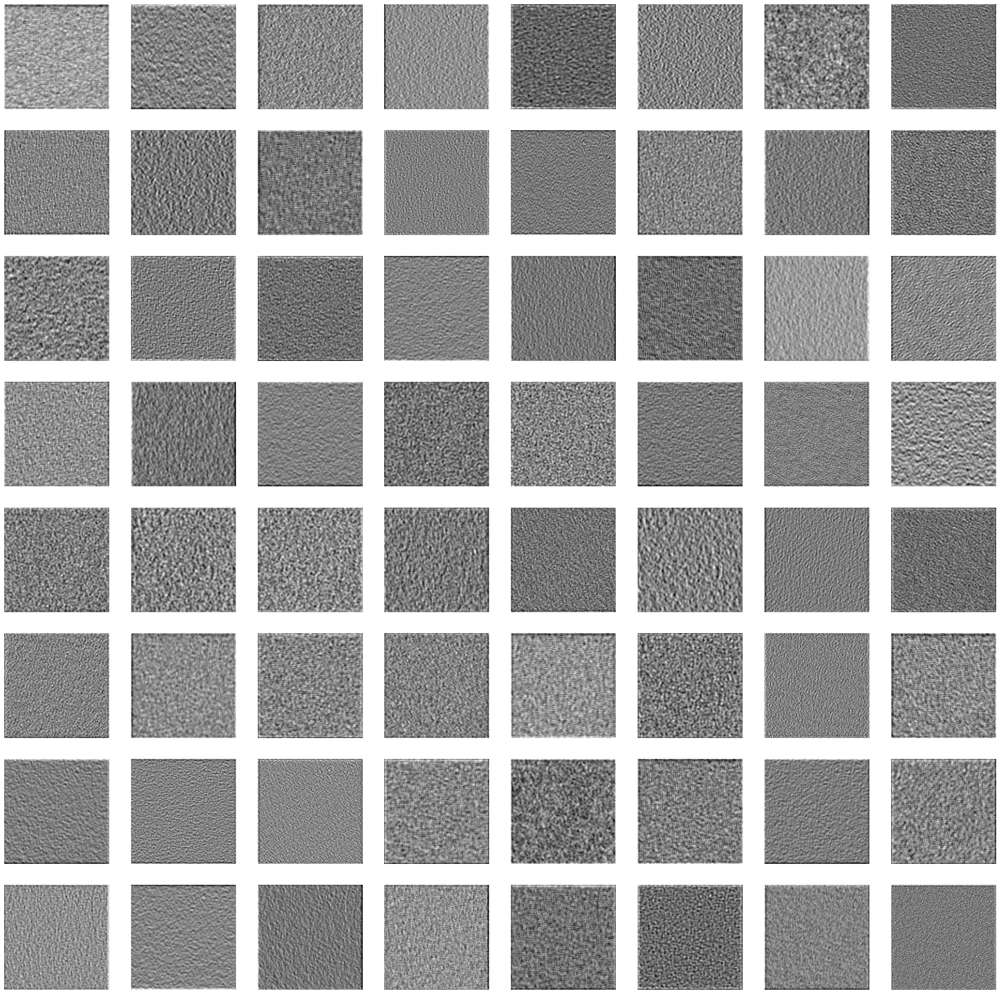

torch.Size([64, 112, 112])
Saving layer 3 feature maps...


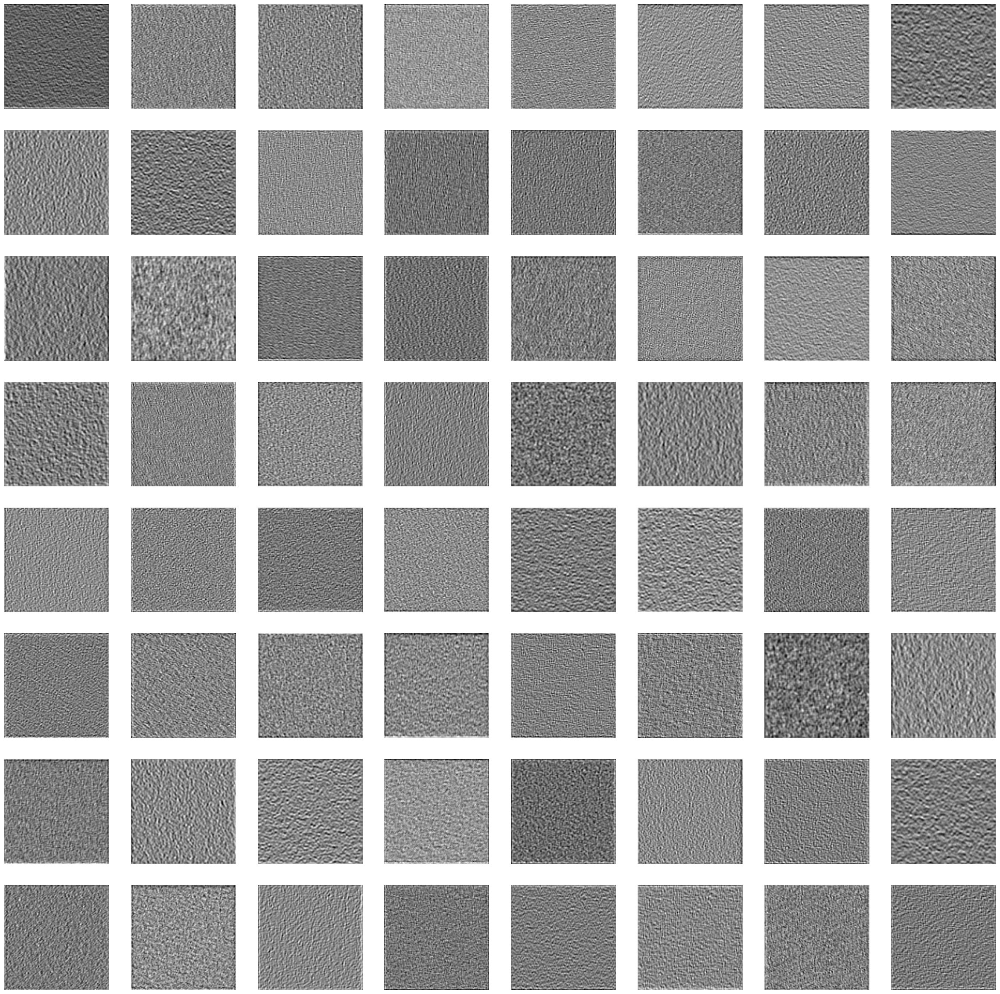

torch.Size([64, 112, 112])
Saving layer 4 feature maps...


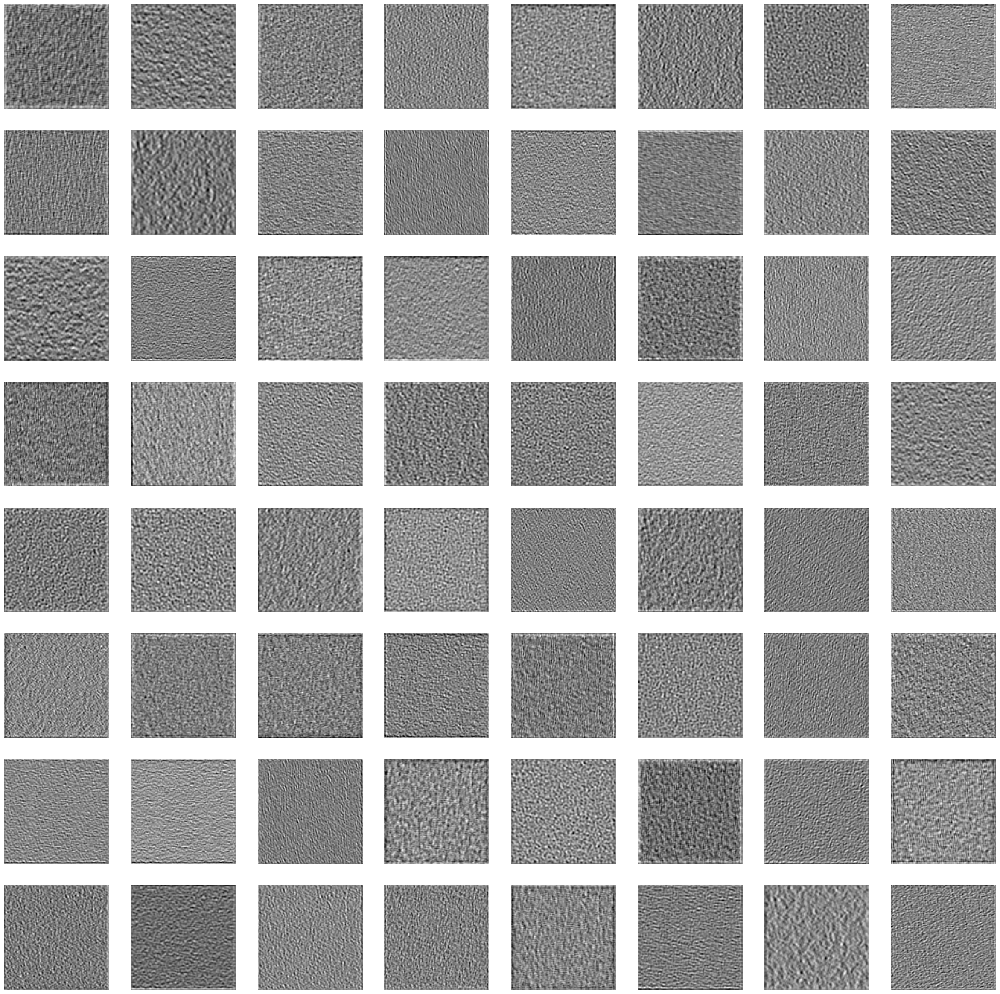

torch.Size([128, 56, 56])
Saving layer 5 feature maps...


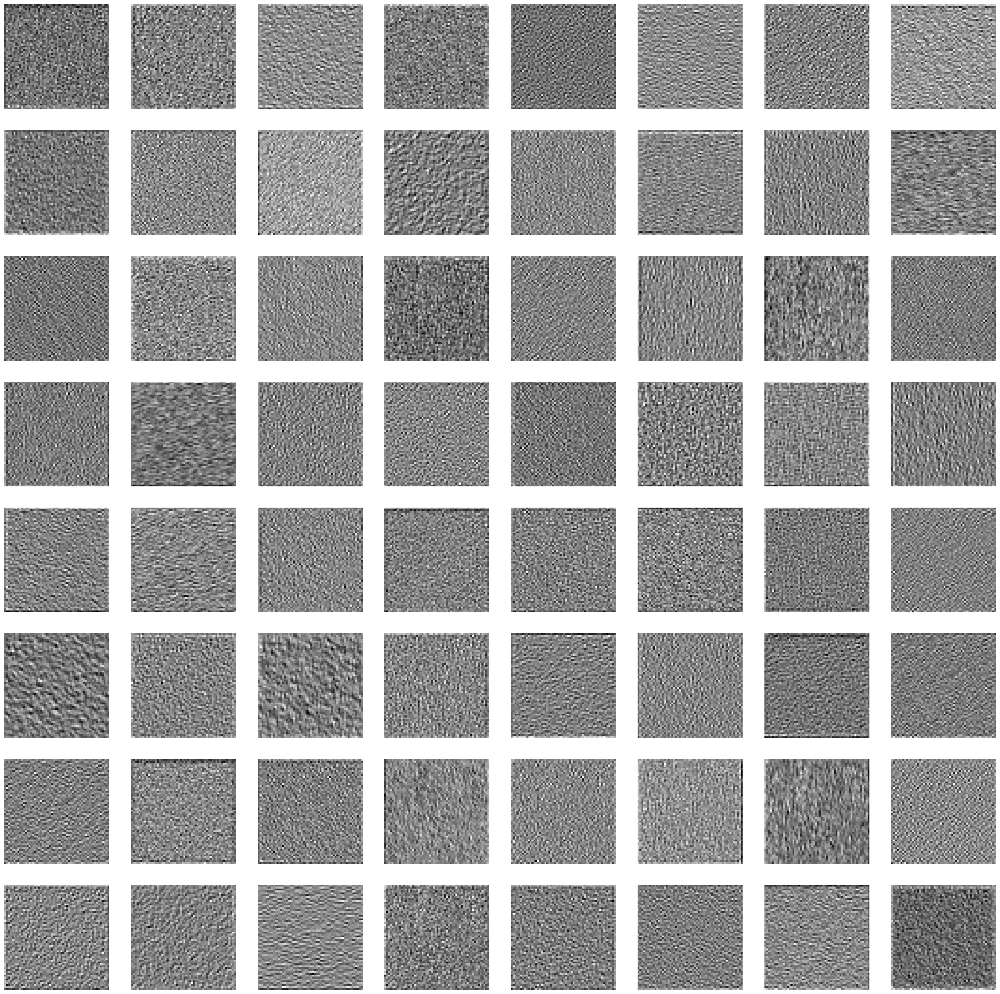

torch.Size([128, 56, 56])
Saving layer 6 feature maps...


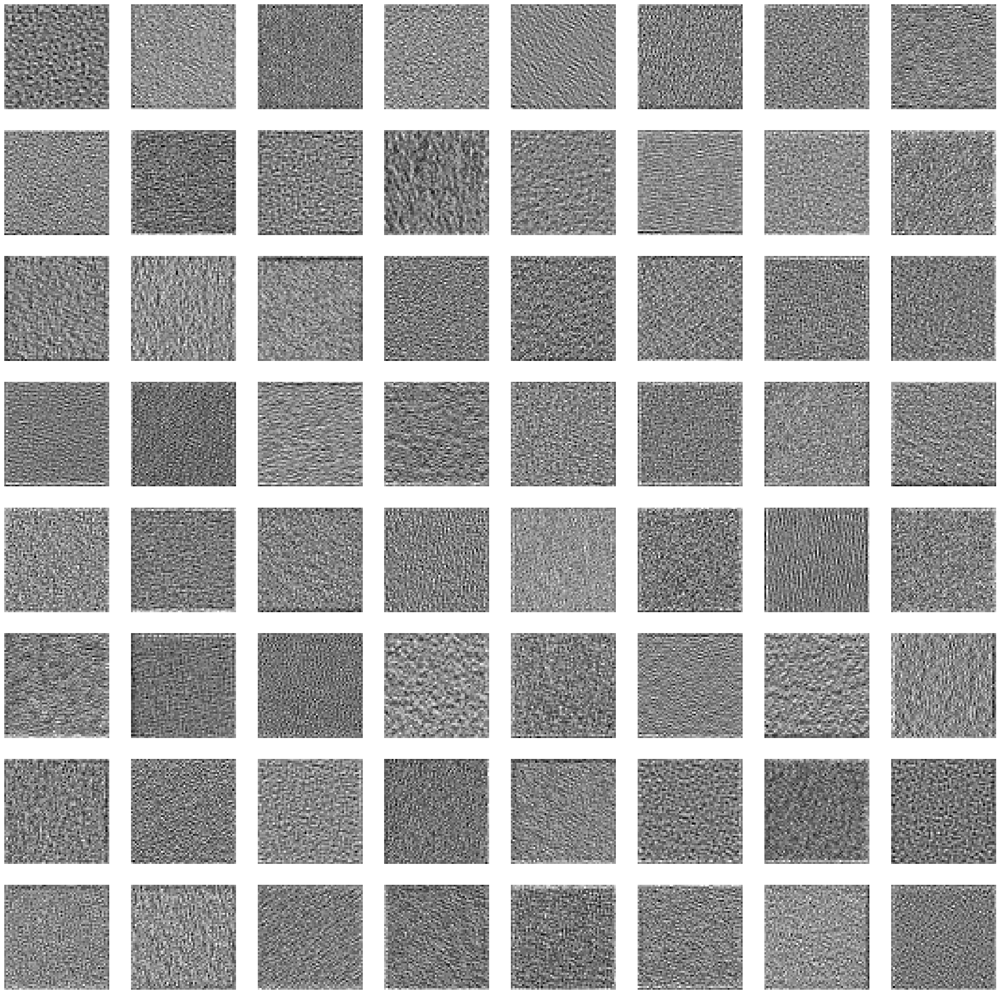

torch.Size([128, 56, 56])
Saving layer 7 feature maps...


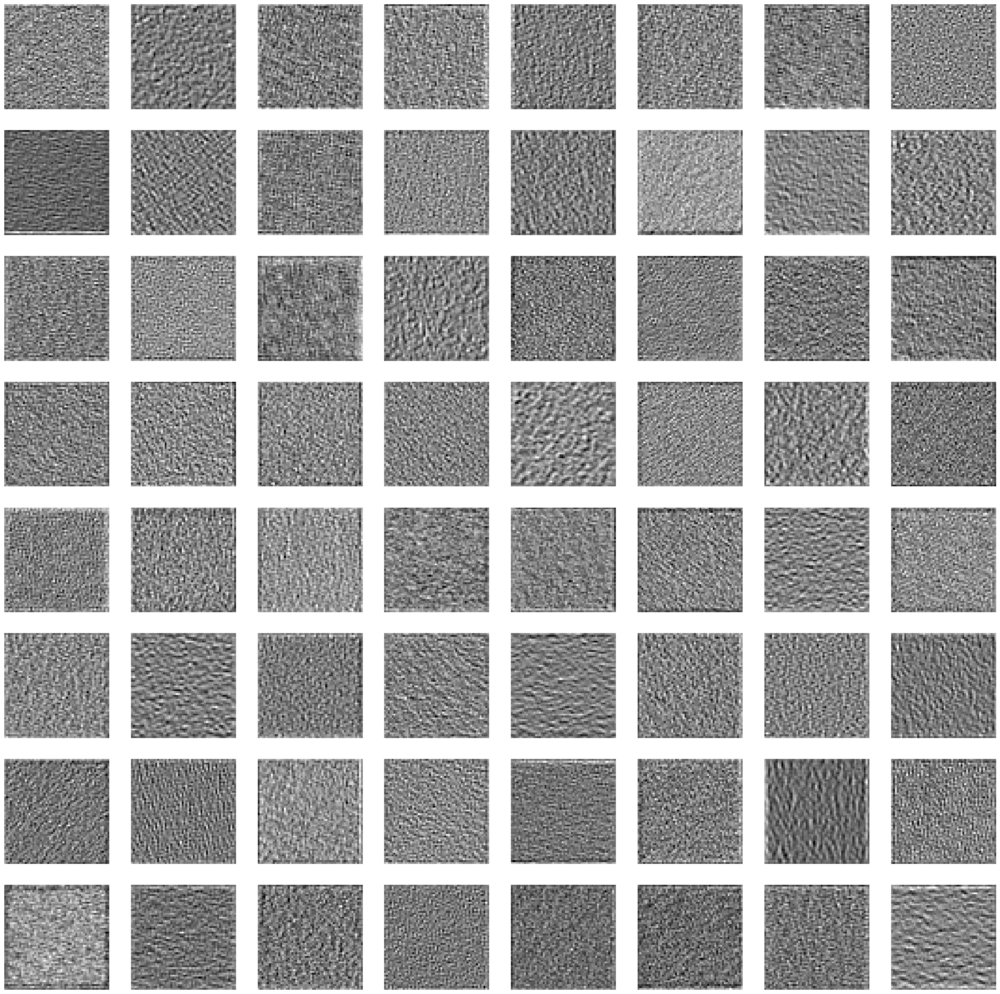

torch.Size([128, 56, 56])
Saving layer 8 feature maps...


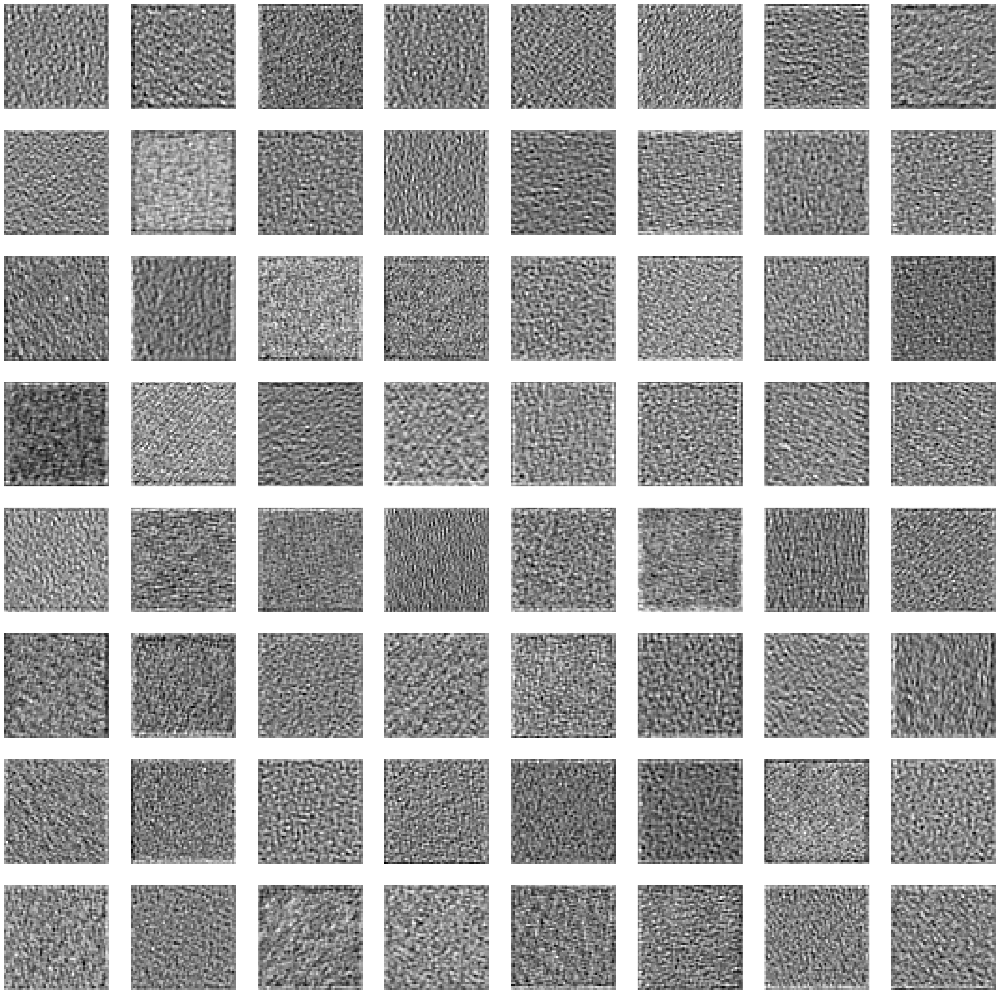

torch.Size([256, 28, 28])
Saving layer 9 feature maps...


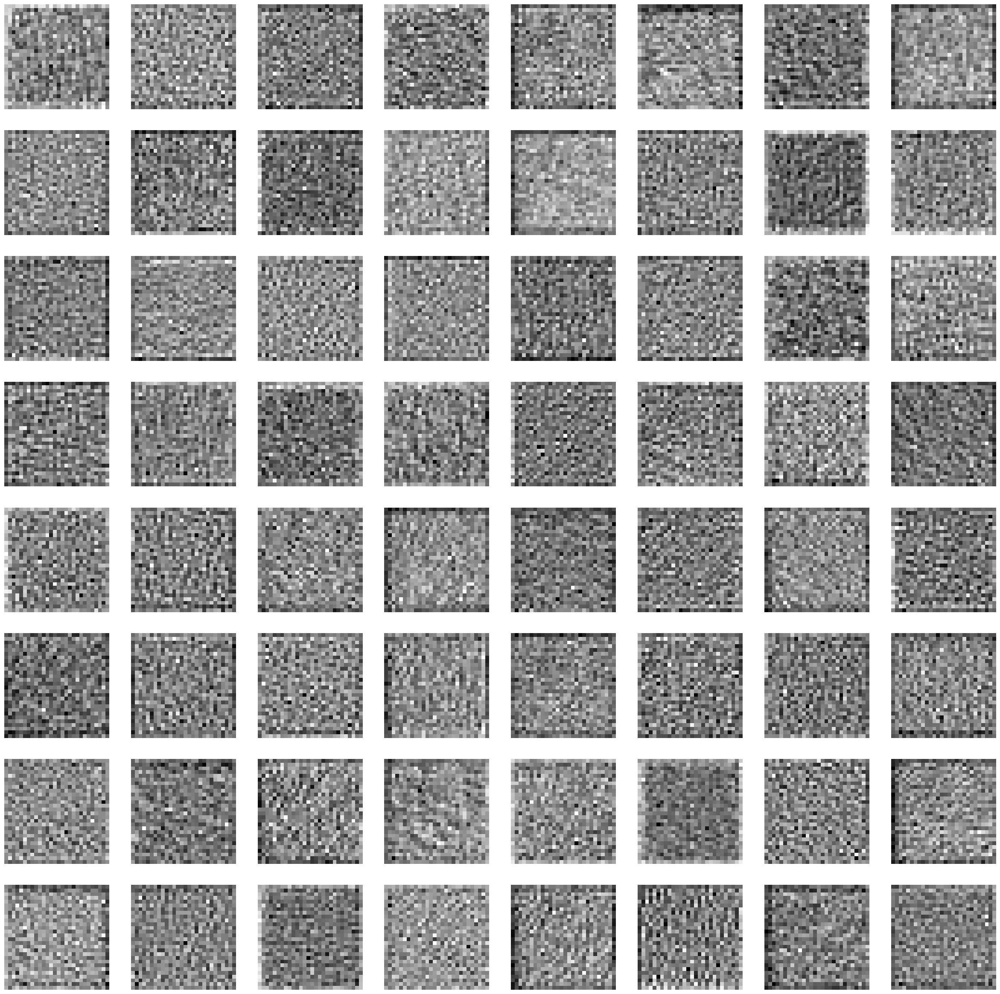

torch.Size([256, 28, 28])
Saving layer 10 feature maps...


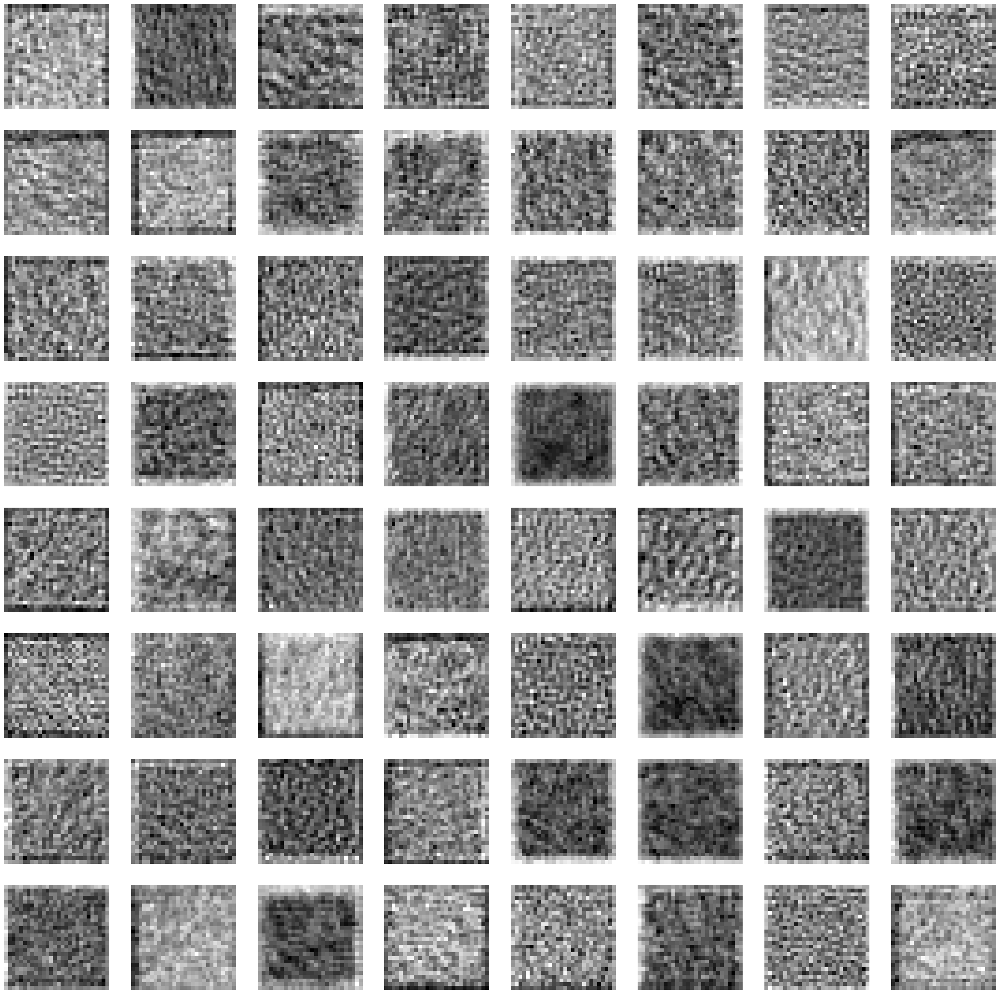

torch.Size([256, 28, 28])
Saving layer 11 feature maps...


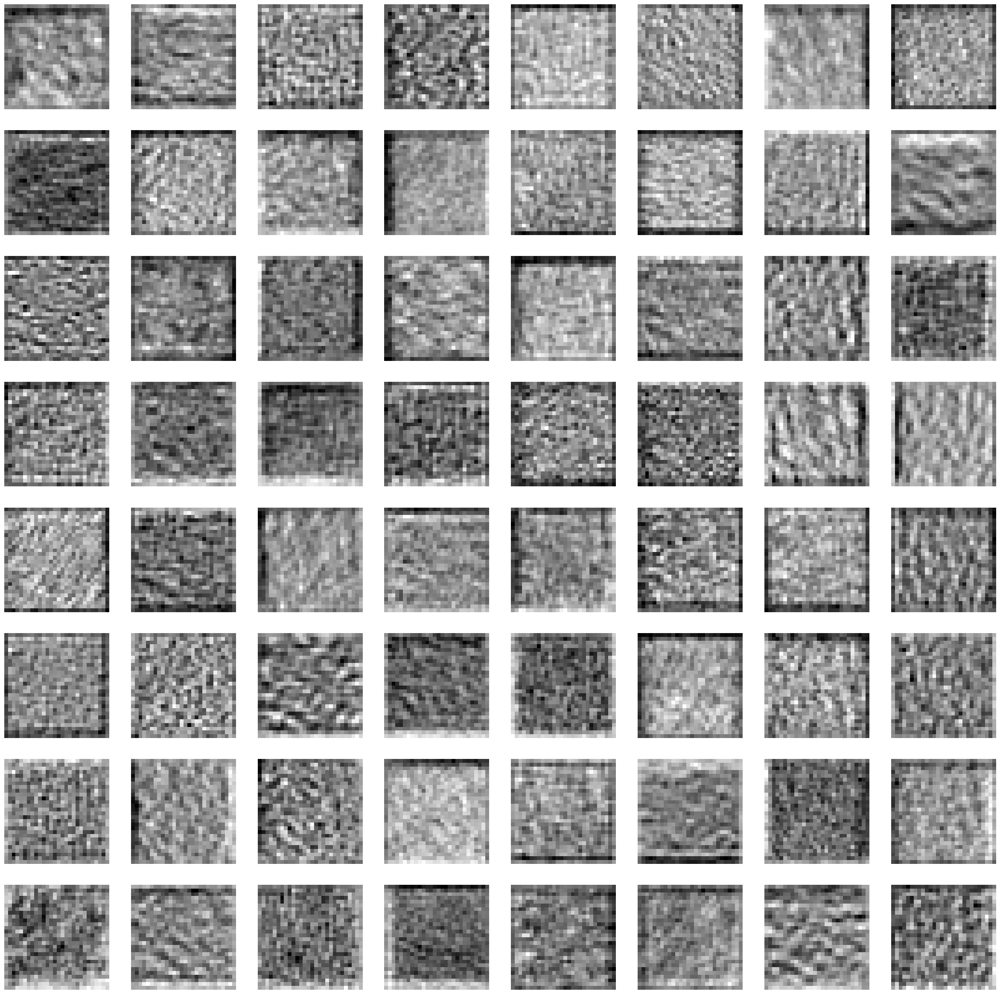

torch.Size([256, 28, 28])
Saving layer 12 feature maps...


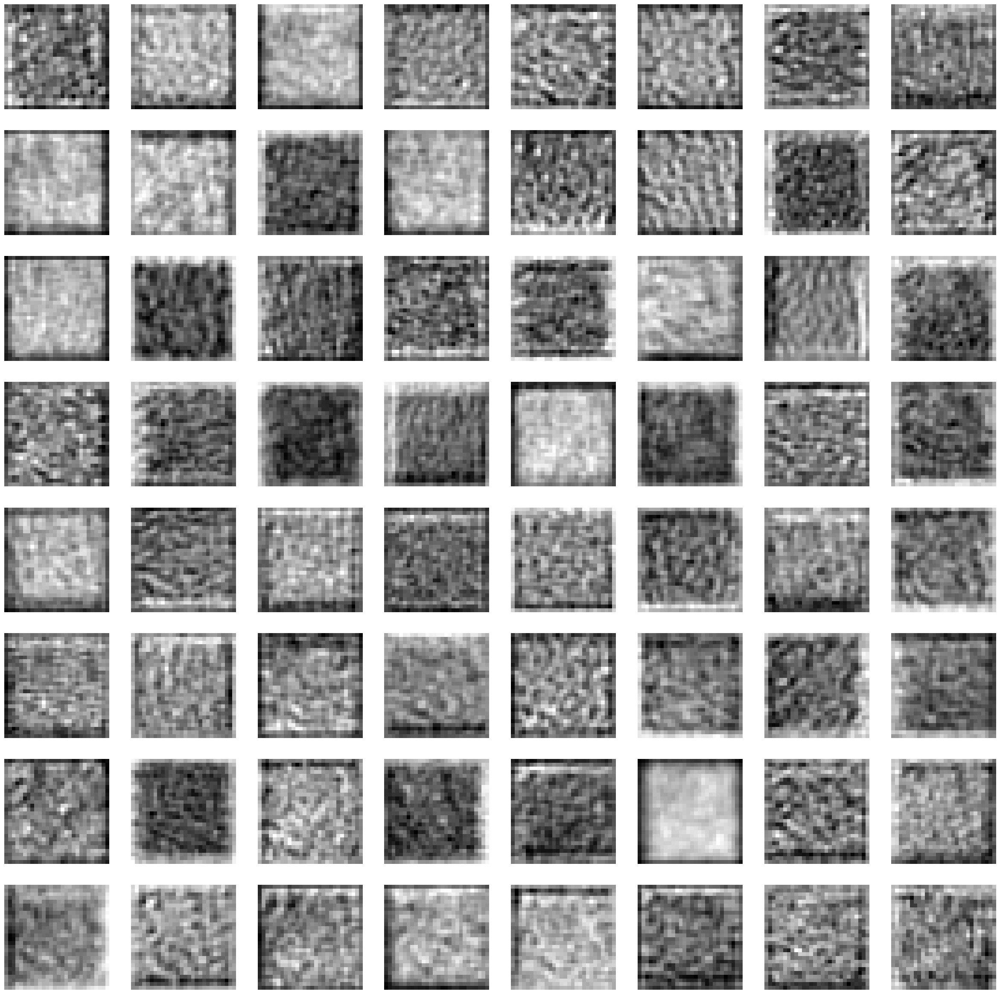

torch.Size([512, 14, 14])
Saving layer 13 feature maps...


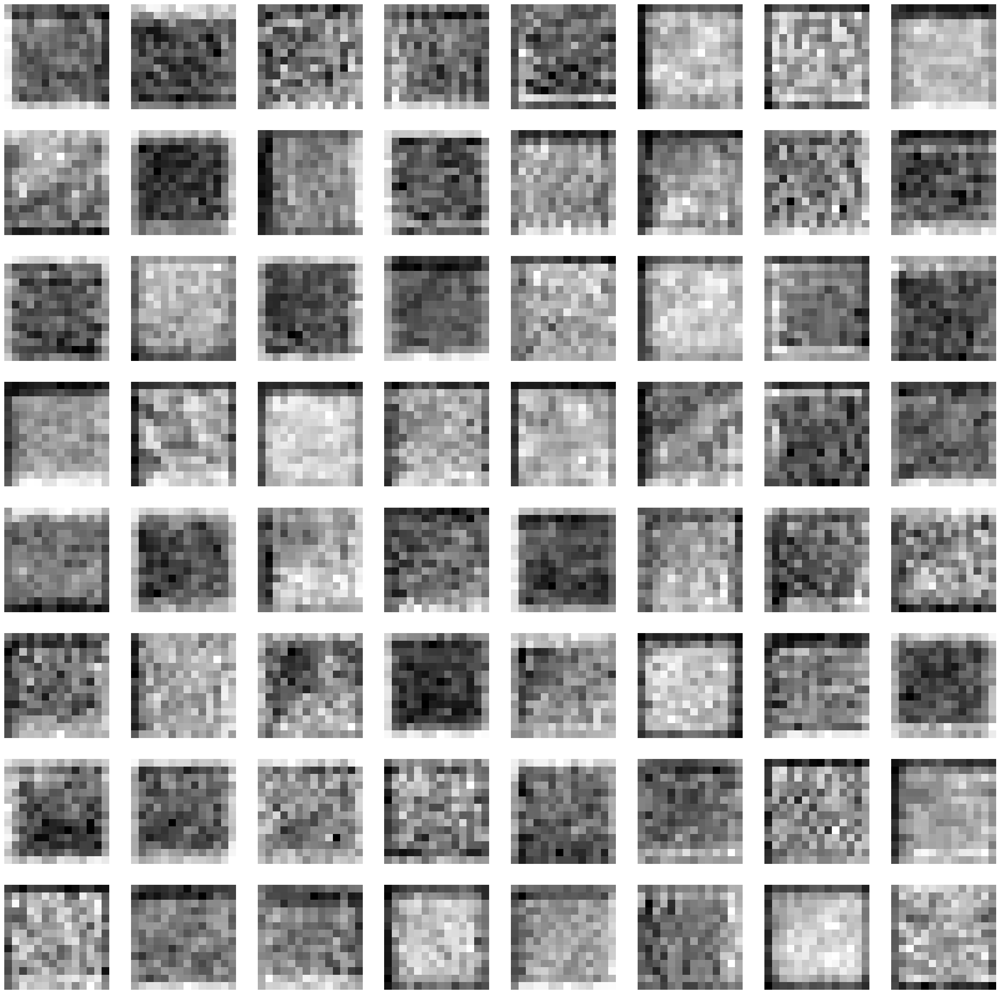

torch.Size([512, 14, 14])
Saving layer 14 feature maps...


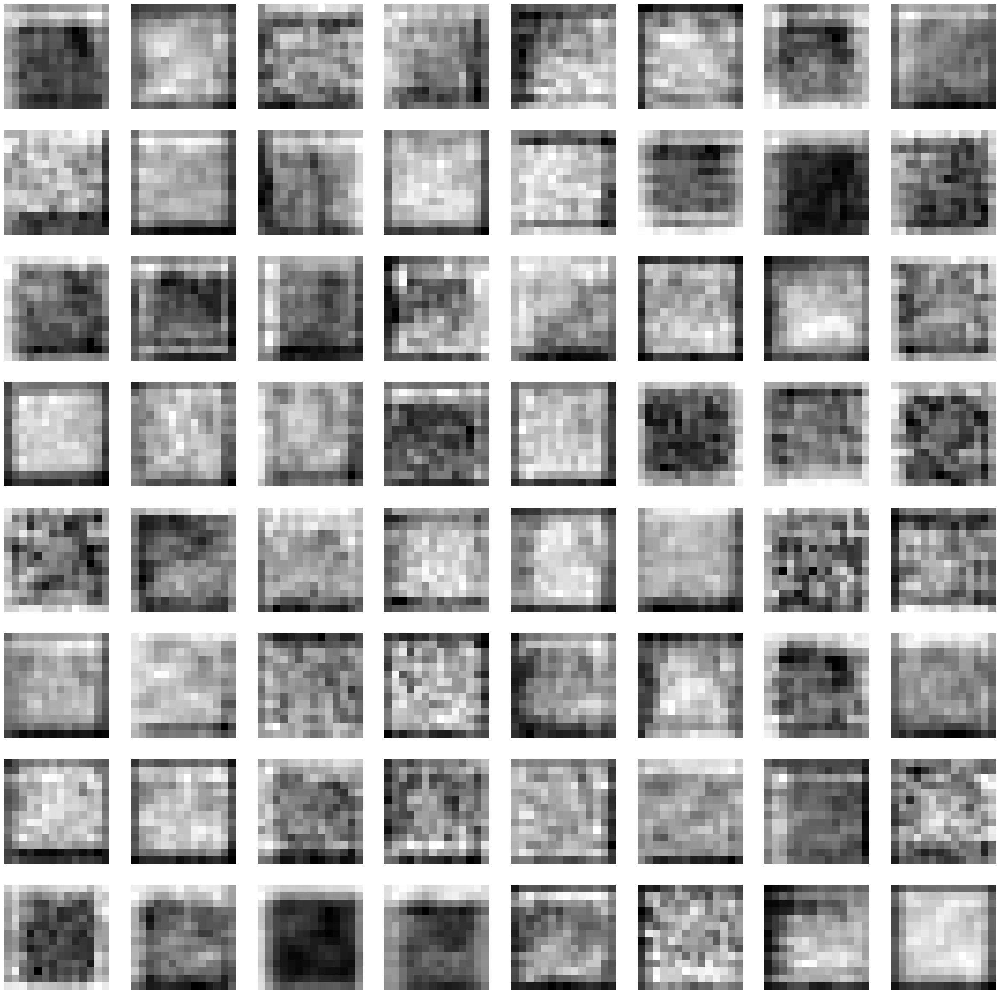

torch.Size([512, 14, 14])
Saving layer 15 feature maps...


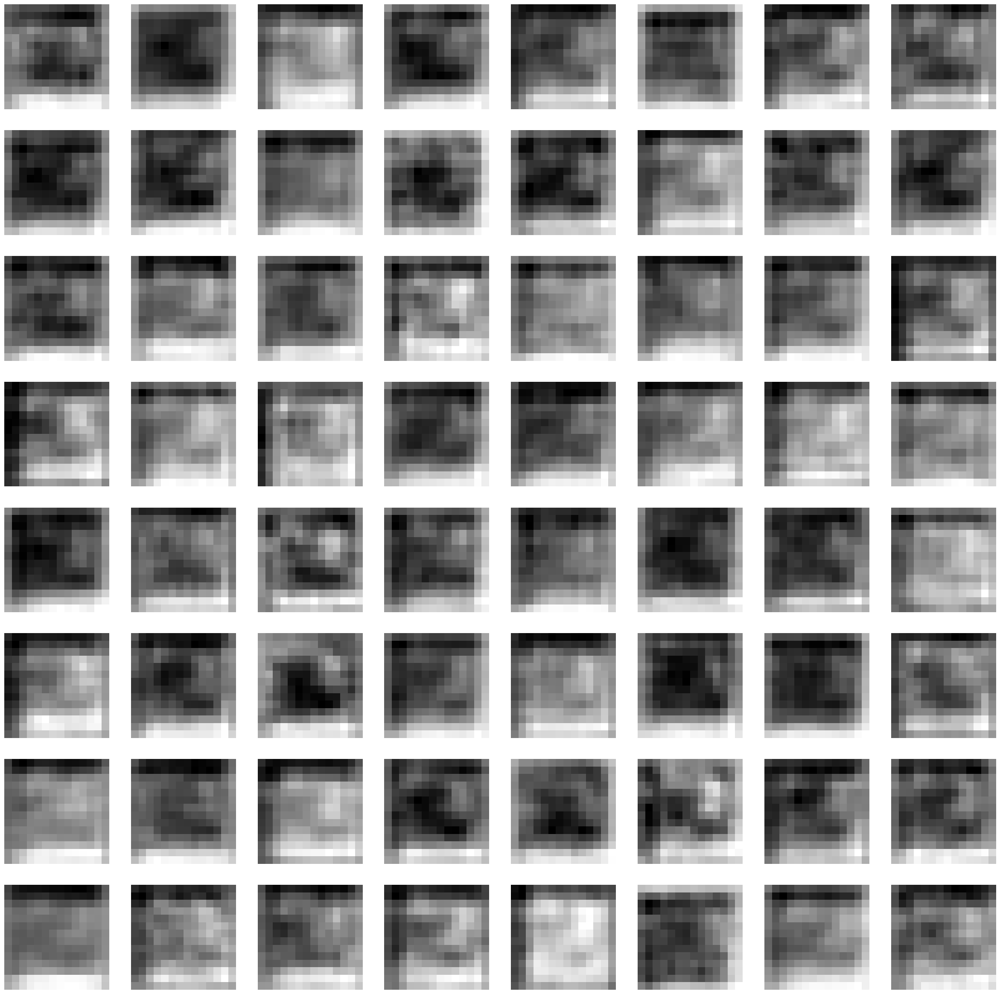

torch.Size([512, 14, 14])
Saving layer 16 feature maps...


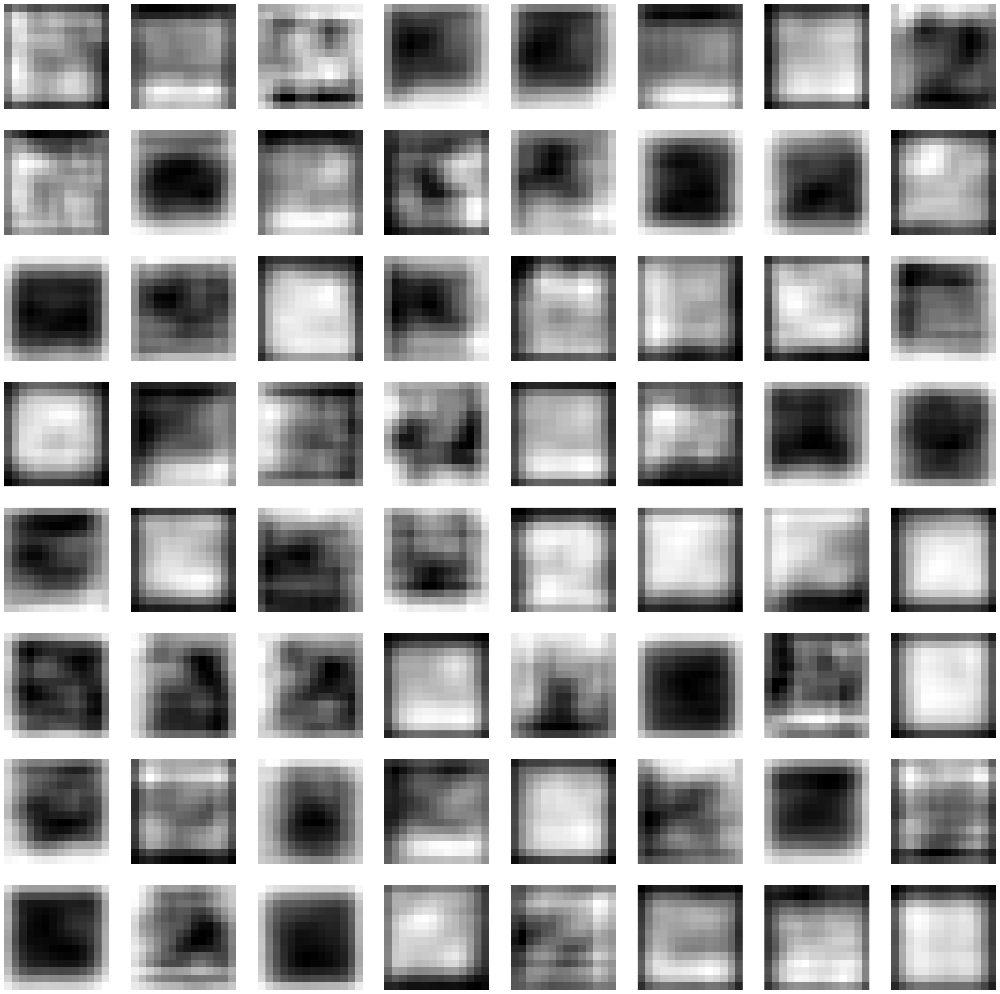

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch.nn as nn
from typing import List
import torch

class ConvolutionalLayerVisualizer:
    """
    A class to visualize the filters and feature maps of convolutional layers in a PyTorch model.
    """
    
    def __init__(self, model: nn.Module):
        """
        Initializes the ConvolutionalLayerVisualizer object.

        Args:
            model (nn.Module): The PyTorch model to visualize.
        """
        self.model = model
        self.model_weights = []
        self.conv_layers = []
        self.counter = 0
        self.device = 'cpu'  # default device
        
    def set_device(self, device: str):
        """
        Sets the device to use for computations (e.g. 'cpu' or 'cuda').

        Args:
            device (str): The name of the device.
        """
        self.device = device
        
    def get_conv_layers(self) -> List[nn.Conv2d]:
        """
        Finds all convolutional layers in the model and saves their weights and module objects.

        Returns:
            List[nn.Conv2d]: A list of all convolutional layers in the model.
        """
        model_children = list(self.model.children())
        for i in range(len(model_children)):
            if type(model_children[i]) == nn.Conv2d:
                self.counter += 1
                self.model_weights.append(model_children[i].weight)
                self.conv_layers.append(model_children[i])
            elif type(model_children[i]) == nn.Sequential:
                for j in range(len(model_children[i])):
                    for child in model_children[i][j].children():
                        if type(child) == nn.Conv2d:
                            self.counter += 1
                            self.model_weights.append(child.weight)
                            self.conv_layers.append(child)
        print(f"Total convolutional layers: {self.counter}")
        return self.conv_layers
        
    def plot_filters(self, layer: int, figsize: tuple = (20, 17)):
        """
        Plots the filters for a given convolutional layer.

        Args:
            layer (int): The index of the convolutional layer to visualize.
            figsize (tuple, optional): The size of the figure. Defaults to (20, 17).
        """
        plt.figure(figsize=figsize)
        for i, filter in enumerate(self.model_weights[layer]):
            plt.subplot(8, 8, i+1) 
            plt.imshow(filter[0, :, :].detach().cpu(), cmap='gray')
            plt.axis('off')
        plt.show()
        
    def visualize_layers(self, input_batch: torch.Tensor, figsize: tuple = (30, 30)):
        """
        Computes and plots the feature maps for all convolutional layers in the model.

        Args:
            input_batch (torch.Tensor): The input batch to feed through the model.
            figsize (tuple, optional): The size of the figure. Defaults to (30, 30).
        """
        input_batch = input_batch.to(self.device)
        outputs = [self.conv_layers[0](input_batch)]
        for i in range(1, len(self.conv_layers)):
            outputs.append(self.conv_layers[i](outputs[-1]))
        for idx in range(len(outputs)):
            plt.figure(figsize=figsize)
            layer_data = outputs[idx][0, :, :, :]
            layer_data = layer_data.data.cpu()
            print(layer_data.size()) # [64, 112, 112]
            for i, filter in enumerate(layer_data):
                if i == 64: 
                    break
                plt.subplot(8, 8, i + 1)
                plt.imshow(filter, cmap='gray')
                plt.axis("off")
            print(f"Saving layer {idx} feature maps...")
            plt.show()
        plt.close()

#Calls for part 2
from torchvision.models import resnet18

model = resnet18(pretrained=True)

visualizer = ConvolutionalLayerVisualizer(model)
visualizer.set_device('cpu')  # use GPU device
conv_layers = visualizer.get_conv_layers()

input_tensor = torch.rand(1, 3, 224, 224).to('cpu')
visualizer.plot_filters(0)
visualizer.visualize_layers(input_tensor)

# Question 3: 

For this problem you may use a toolbox (and you must use PyTorch). We will do image
classification using the Oxford Pet Dataset. The dataset consists of 37 categories with
about 200 images in each of them. You can find the dataset here: http://www.robots.
ox.ac.uk/~vgg/data/pets/ <br>

<br>
Rather than using the final ‘softmax’ layer of the CNN as output to make predictions
as we did in problem 2, instead we will use the CNN as a feature extractor to classify
the Pets dataset. For each image, grab features from the last hidden layer of the neural
network, which will be the layer before the 1000-dimensional output layer (around 500–
6000 dimensions). You will need to resize the images to a size compatible with your
network (usually 224 ×224 ×3, but look at the documentation for the pre-trained system
you selected). You should grab the output just after the last hidden layer or after global
pooling (if it is 1000-dimensional, you will know you did it wrong).<br>

<br>After you extract these features for all of the images in the dataset, normalize them to
unit length by dividing by the L2 norm. Train a linear classifier of your choice1 with the
training CNN features, and then classify the test CNN features. Report mean-per-class
accuracy and discuss the classifier you used.

# Question 4 Training a Small CNN

# Question 5 Vision Transformers 
In this problem, you will redo problem 3, but instead of transfer learning with a CNN, you
will do transfer learning with a Vision Transformer. Identify a strong vision transformer
architecture for transfer learning that was pre-trained on ImageNet-1K (note that some
pre-trained models are pre-trained on larger datasets). We suggest using Swin Transformers
or later incarnations of them. You will have to download the pre-trained model and the
appropriate code.<br>
<br>Briefly discuss the Vision Transformer you selected. Compare performance of the Vision
Transformer to the CNN you used earlier in terms of overall performance. Are there
some images that the CNN gets correct but the Swin Transformer misclassifies, and vice
versa?

# Question 6 BatchNorm - Investigations

In this bonus problem, you will study BatchNorm’s properties for a single ‘dot prod-
uct’ neuron, but the results are the same if you have multiple neurons in a layer or use
convolutional units.
Let
xi = wT hi + b
be the output of the neuron, where hi ∈Rd is a vector of inputs to the neuron, w ∈Rd are
the weights of the neuron, and b is the bias. BatchNorm is applied in the subsequent ‘layer’
before the non-linearity. After computing the activation of the neuron, the BatchNorm
transformation of the output activations is given by
ˆxi = xi −μB√
σ2B + ε
,
5
where the mean of the activation in the mini-batch is given by
μB = 1
m
m∑
i=1
xi,
the variance is given by
σ2B = 1
m
m∑
i=1
(xi −μB )2,
and where m is the mini-batch size.
Substitute in the neuron’s activation function into the BatchNorm equations and simplify.
What does this tell you about how BatchNorm impacts the weights and the bias of the neu-
ron? How should you adjust your neural network’s architecture if using BatchNorm?

# Question 7 Fooling Convolutional Neural Networks 
In this problem you will fool the pre-trained convolutional neural network of your choice.
One of the simplest ways to do this is to add a small amount of adversarial noise to the input
image, which causes the correct predicted label ytrue to switch to an incorrect adversarial
label yf ool, despite the image looking the same to our human visual system.